In [ ]:
import cv2
import dlib
from google.colab.patches import cv2_imshow

In [ ]:
face_cascade = cv2.CascadeClassifier(cv2.samples.findFile(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml'))

In [ ]:
!pip install face_recognition

     |████████████████████████████████| 100.1 MB 22 kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566185 sha256=87e6b69f51bc7492e2a2dd486490213b37ac8fb65bb16cdfbb8fa243d7e7f97c
  Stored in directory: /root/.cache/pip/wheels/d6/81/3c/884bcd5e1c120ff548d57c2ecc9ebf3281c9a6f7c0e7e7947a
Successfully built face-recognition-models


In [ ]:
import face_recognition 

In [ ]:
import numpy as np 
from google.colab.patches import cv2_imshow 

In [ ]:
imgElon=face_recognition.load_image_file('sample_data/ImageBasics/elon_musk.jpg')

In [ ]:
imgElon=cv2.cvtColor(imgElon,cv2.COLOR_BGR2RGB)

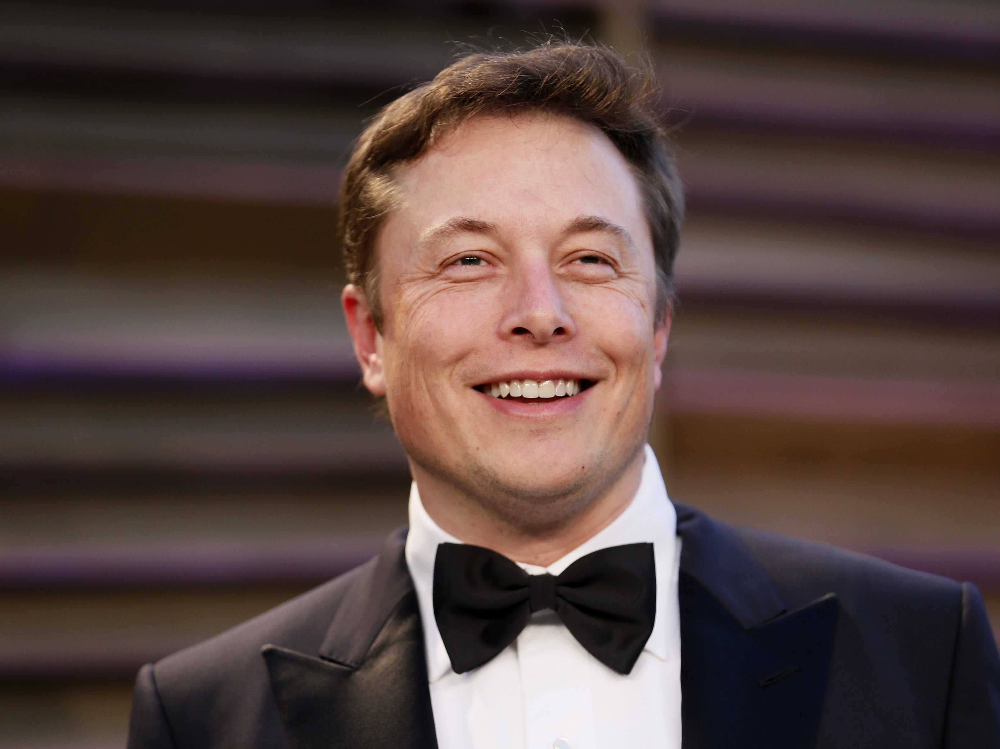

In [ ]:
cv2_imshow(imgElon)


In [ ]:
imgTest=face_recognition.load_image_file('sample_data/ImageBasics/elon_test.jpg')

In [ ]:
imgTest=cv2.cvtColor(imgTest,cv2.COLOR_BGR2RGB)

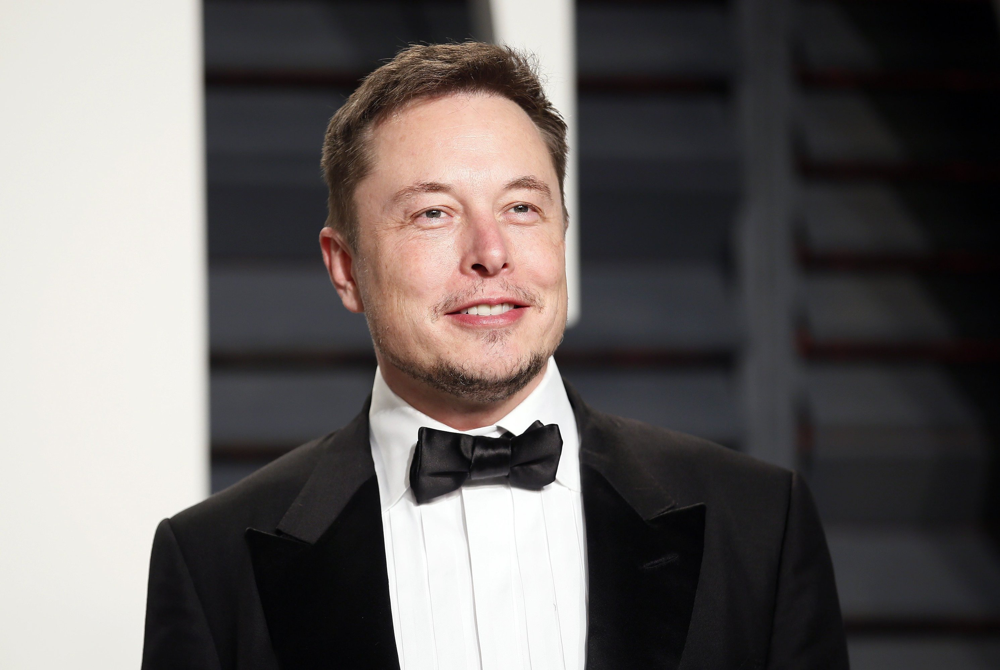

In [ ]:
cv2_imshow(imgTest)

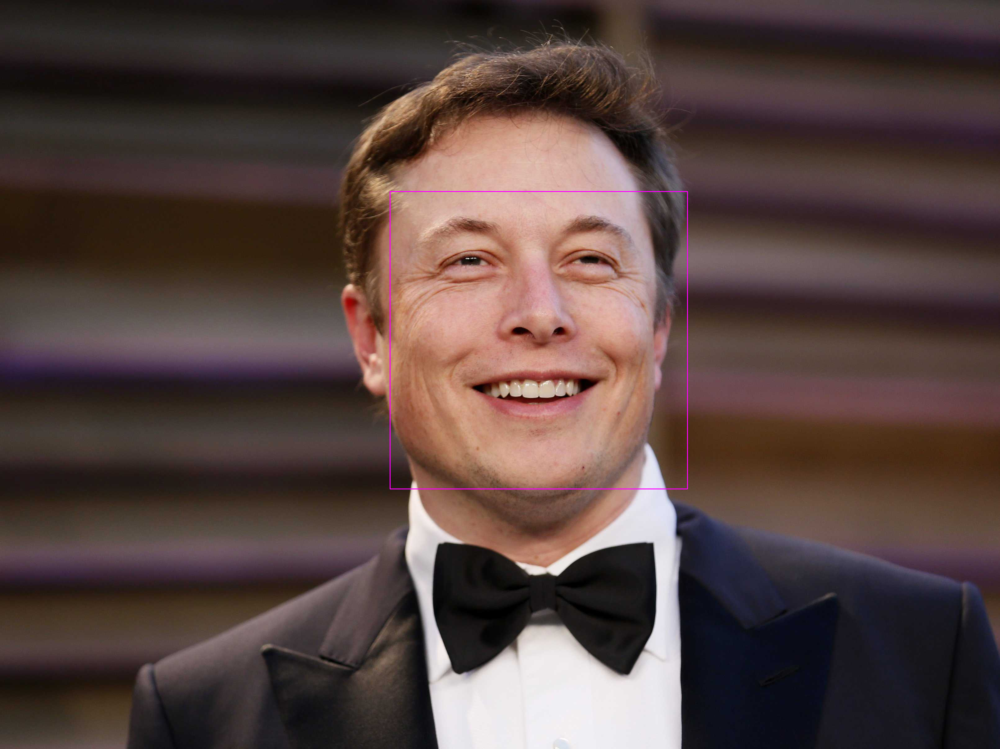

In [ ]:
faceLoc=face_recognition.face_locations(imgElon)[0]
encodeElon = face_recognition.face_encodings(imgElon)[0]
cv2.rectangle(imgElon,(faceLoc[3],faceLoc[0]),(faceLoc[1],faceLoc[2]),(255,0,255),2)
cv2_imshow(imgElon)

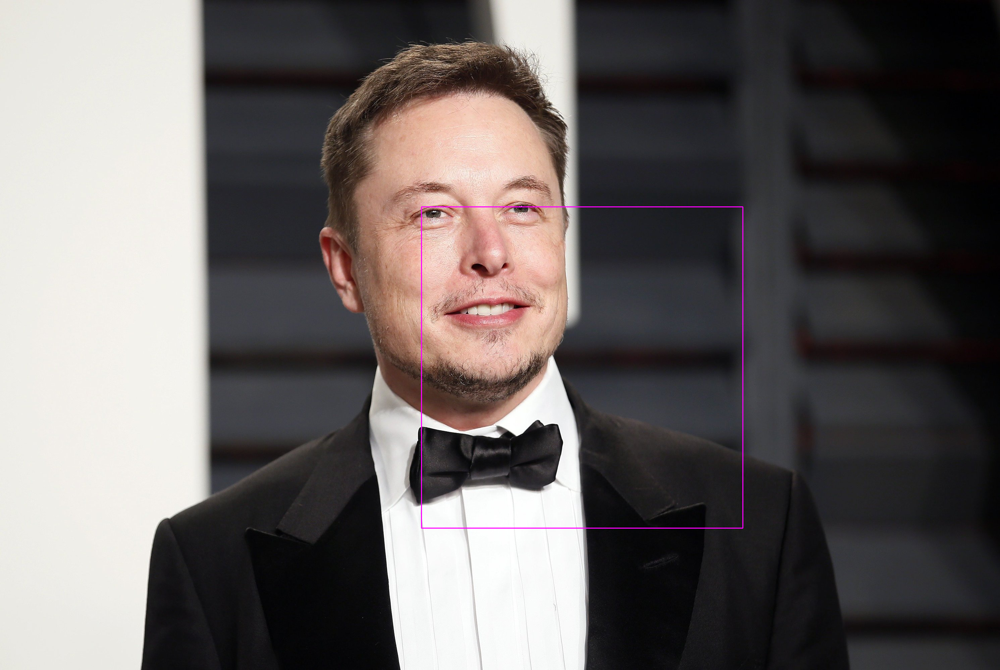

In [ ]:
faceLocTest=face_recognition.face_locations(imgTest)[0]
encodeElonTest = face_recognition.face_encodings(imgTest)[0]
cv2.rectangle(imgTest,(faceLoc[3],faceLoc[0]),(faceLoc[1],faceLoc[2]),(255,0,255),2)
cv2_imshow(imgTest)

In [ ]:
results=face_recognition.compare_faces([encodeElon],encodeElonTest)
print(results)

[True]


In [ ]:
faceDis=face_recognition.face_distance([encodeElon],encodeElonTest)
print(faceDis)

[0.33593162]


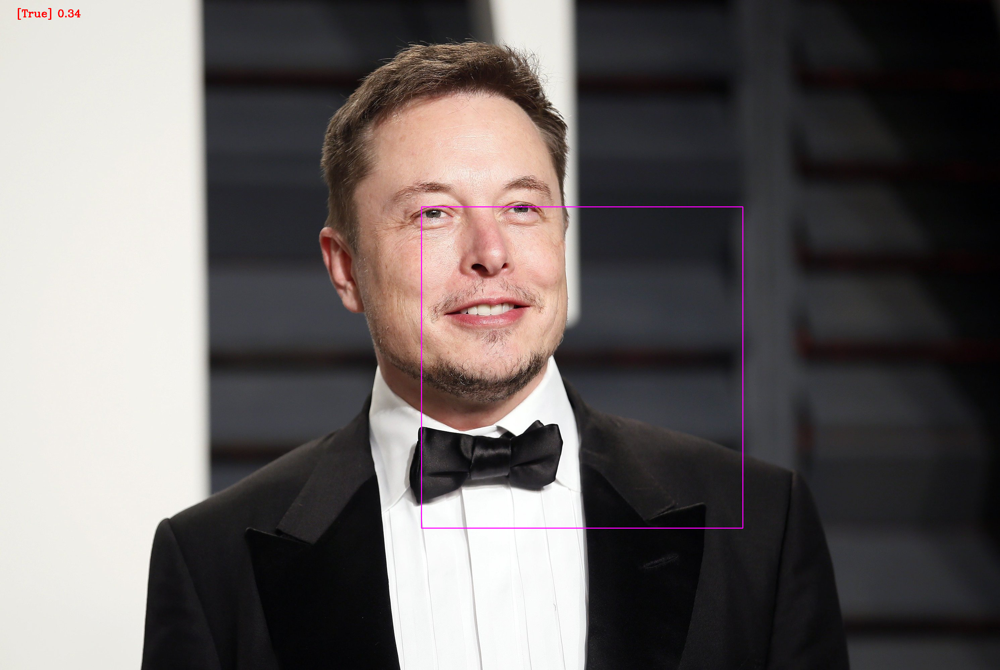

In [ ]:
cv2.putText(imgTest,f'{results} {round(faceDis[0],2)}',(50,50),cv2.FONT_HERSHEY_COMPLEX,1,(0,0,255),2)
cv2_imshow(imgTest)

In [ ]:
import os 

In [ ]:
path = 'sample_data/ImagesAttendance'
images =[]
classNames = []

myList=[f for f in os.listdir(path) if not f.startswith('.')]
print(myList)

['elon_musk.jpg', 'bill_gates.jpg', 'jack_ma.jpg']


In [ ]:
for cl in myList:
  curImg = cv2.imread(f'{path}/{cl}')
  images.append(curImg)
  classNames.append(os.path.splitext(cl)[0])
print(classNames)

['elon_musk', 'bill_gates', 'jack_ma']


In [ ]:
def findEncodings(images):
  encodeList = []
  for img in images :
    img =cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    encode = face_recognition.face_encodings(img)[0]
    encodeList.append(encode)
  return encodeList 

encodeListKnown = findEncodings(images)
print('Encoding Complete')

Encoding Complete


In [ ]:
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import PIL
import io
import html
import time

In [ ]:
face_cascade = cv2.CascadeClassifier(cv2.samples.findFile(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml'))

In [ ]:
# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

In [ ]:
def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)

  # get photo data
  data = eval_js('takePhoto({})'.format(quality))
  # get OpenCV format image
  img = js_to_image(data) 
  # grayscale img
  gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
  print(gray.shape)
  # get face bounding box coordinates using Haar Cascade
  faces = face_cascade.detectMultiScale(gray)
  # draw face bounding box on image
  for (x,y,w,h) in faces:
      img = cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
  # save image
  cv2.imwrite(filename, img)

  return img

In [115]:
try:
  filename = take_photo('photo.jpg')
  print('Captured Successfully')
  
  # Show the image which was just taken.
  # display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

(480, 640)
Captured Successfully


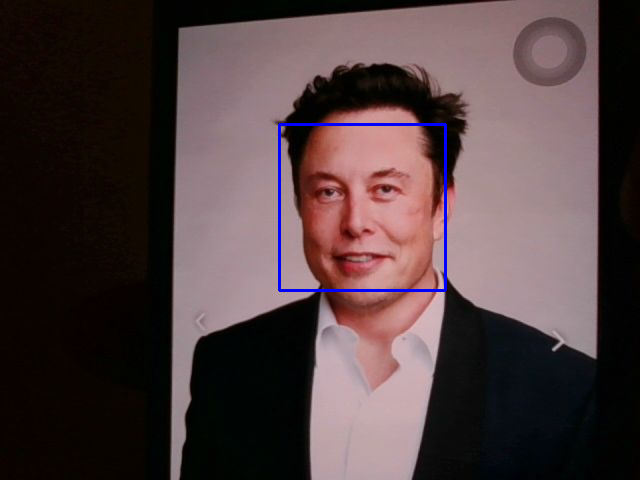

In [116]:
import matplotlib.pyplot as plt
cv2_imshow(filename)

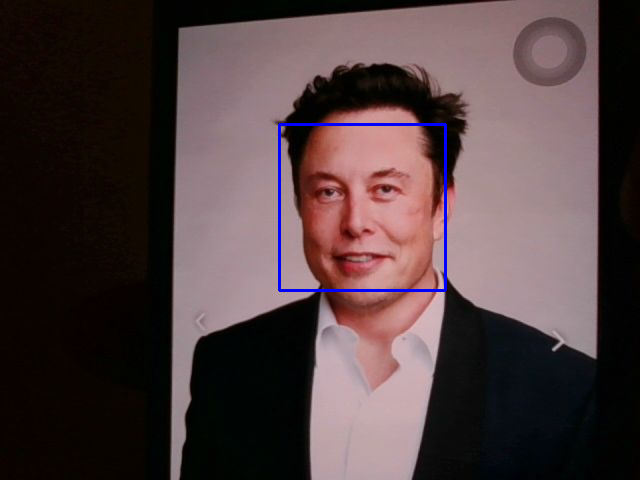

In [117]:
face_location_webcam = face_recognition.face_locations(filename)
encode_webcam_image = face_recognition.face_encodings(filename,face_location_webcam)
# cv2.rectangle(filename,(face_location_test[3],face_location_test[0]),(face_location_test[1],face_location_test[2]),(255,0,255),2)
cv2_imshow(filename)

In [110]:
import csv 
    
# field names 
fields = ['Name','Time'] 
        
# name of csv file 
filename = "Attendance.csv"
    
# writing to csv file 
with open(filename, 'w') as csvfile: 
    # creating a csv writer object 
    csvwriter = csv.writer(csvfile) 
    # writing the fields 
    csvwriter.writerow(fields) 

In [118]:
for encodeFace,facelocation in zip(encode_webcam_image,face_location_webcam):
   matches = face_recognition.compare_faces(encodeListKnown,encodeFace)
   faceDis = face_recognition.face_distance(encodeListKnown,encodeFace)
   print(faceDis)
   matchIndex = np.argmin(faceDis)

   if matches[matchIndex]:
     name=classNames[matchIndex].upper()
     #print(name)
     markAttendance(name) 
     print("MATCH FOUND")
    
   else:
     print("MATCH NOT FOUND")

[0.4571263  0.77298879 0.78482194]
MATCH FOUND


In [119]:
from datetime import datetime
from pytz import timezone
def markAttendance(name):
  with open('sample_data/Attendance.csv','r+') as f:
    myDataList = f.readlines()
    nameList = []
    for line in myDataList:
      entry = line.split(',')
      nameList.append(entry[0])
    if name not in nameList:
      now_utc = datetime.now(timezone('UTC'))
      now_asia = now_utc.astimezone(timezone('Asia/Kolkata'))
      # now = datetime.now()
      time = now_asia.strftime('%H:%M:%S')
      f.writelines(f'\n{name},{time}')

      
   


In [120]:
import pandas as pd 
df=pd.read_csv("sample_data/Attendance.csv")
df


,Name,Time
0,jack_ma,05:36:32
1,abc,11:25:44
2,bill gates,11:26:23
3,BILL_GATES,11:33:01
4,ELON_MUSK,11:39:10
